# Working with the PyTorch Dataset

ref: https://pytorch.org/tutorials/beginner/basics/data_tutorial.html

some common datasets are: https://pytorch.org/vision/stable/datasets.html


- All datasets are subclasses of torch.utils.data.Dataset i.e, they have __getitem__ and __len__ methods implemented.
- Hence, they can all be passed to a torch.utils.data.DataLoader which can load multiple samples in parallel using torch.multiprocessing workers.


They all have two common arguments:
transform and target_transform to transform the input and target respectively.

1. Dataset for Image classification:
ref: https://pytorch.org/vision/stable/datasets.html#image-classification

2. Image detection or segmentation
ref: https://pytorch.org/vision/stable/datasets.html#image-detection-or-segmentation

3. Optical Flow
ref: https://pytorch.org/vision/stable/datasets.html#optical-flow

4. Image pairs
ref: https://pytorch.org/vision/stable/datasets.html#image-pairs

5. Text Datasets
6. Audio Datasets

In [1]:
import torch

#  All toy dataset
from torch.utils.data import Dataset

# toy dataset of images
from torchvision.datasets import FashionMNIST, kitti, MNIST, Cityscapes # EuroSAT, Kinetics, OxfordIIITPet, Country211
from torchvision import datasets

import matplotlib.pyplot as plt


In [ ]:
# raise NotImplementedError
# raise PermissionError

date/leftImg8bit_trainextra.zip


# Image Transormations and Functions:

In [129]:
from torchvision.transforms import (ToTensor,     # converts a PIL image --> NumPy 
                                    PILToTensor,  # converts PIL Image --> tensor or an ndarray
                                    ToPILImage)   # tensor or an ndarray --> PIL Image

from torchvision.transforms import (Compose, RandomPerspective,
                                    Pad)

# Random Transformations
from torchvision.transforms import (RandomCrop,
                                    RandomEqualize,
                                    RandomInvert,
                                    RandomRotation,
                                    RandomAdjustSharpness,
                                    RandomGrayscale,
                                    RandomAffine,
                                    RandomSolarize,
                                    RandomHorizontalFlip,
                                    RandomVerticalFlip,
                                    RandomResizedCrop)

# Cropping
from torchvision.transforms import (TenCrop,
                                    FiveCrop,
                                    CenterCrop)
# Advanced Image Processing
from torchvision.transforms import (LinearTransformation,
                                    ColorJitter,
                                    GaussianBlur,
                                    Normalize,
                                    Lambda,  # 
                                    Resize,
                                    )


# Functional Transform
import torchvision.transforms.functional as ttf

# Custom Pixel Manupulation
from torchvision.transforms.functional import (adjust_hue,
                                               adjust_brightness,
                                               adjust_gamma,
                                               adjust_saturation,
                                               adjust_sharpness,
                                               adjust_contrast,
                                               normalize,
                                               )

# Pixel Movement
from torchvision.transforms.functional import (rotate,
                                               resize,
                                               pad,
                                               crop,
                                               center_crop,
                                               resized_crop,
                                               ten_crop,
                                               five_crop,
                                               hflip,
                                               vflip,
                                               invert,
                                               perspective)

# Change Pixel properties
from torchvision.transforms.functional import (affine,
                                               to_grayscale,
                                               rgb_to_grayscale,
                                               erase,
                                               solarize,
                                               posterize,
                                               autocontrast,
                                               equalize)


## Demo for Pixel Movement


ERROR: Could not find a version that satisfies the requirement PIL (from versions: none)
ERROR: No matching distribution found for PIL


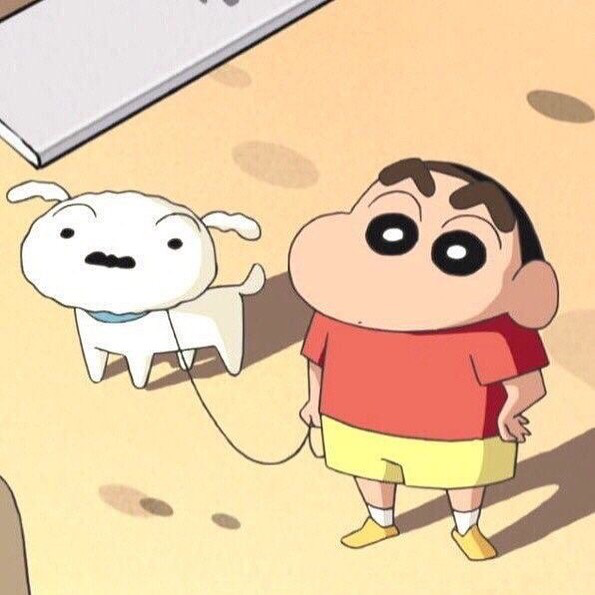

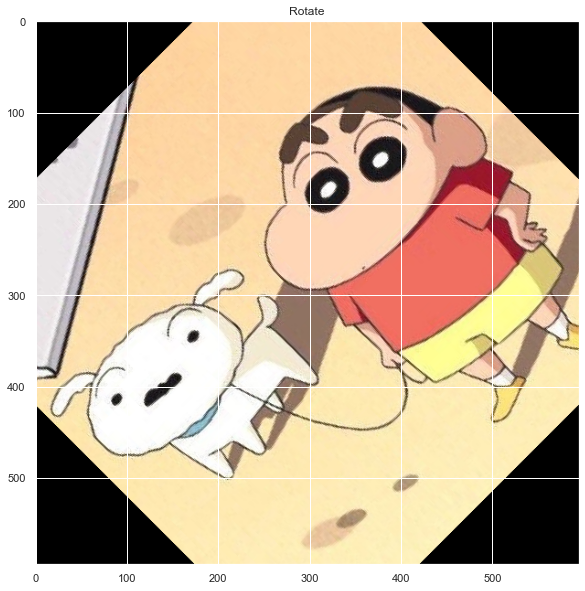

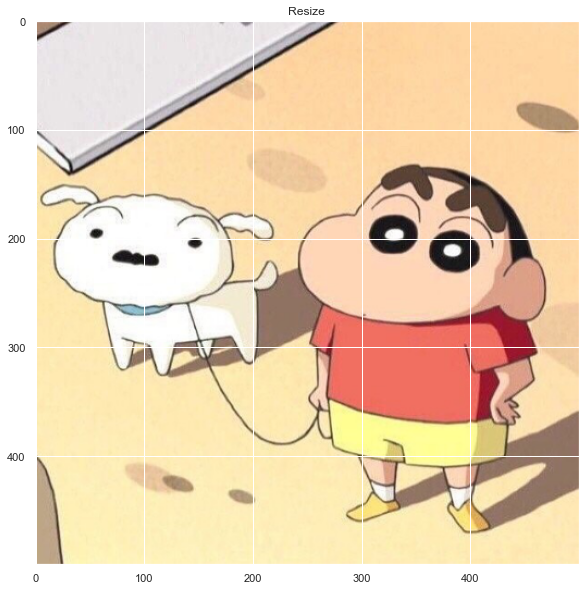

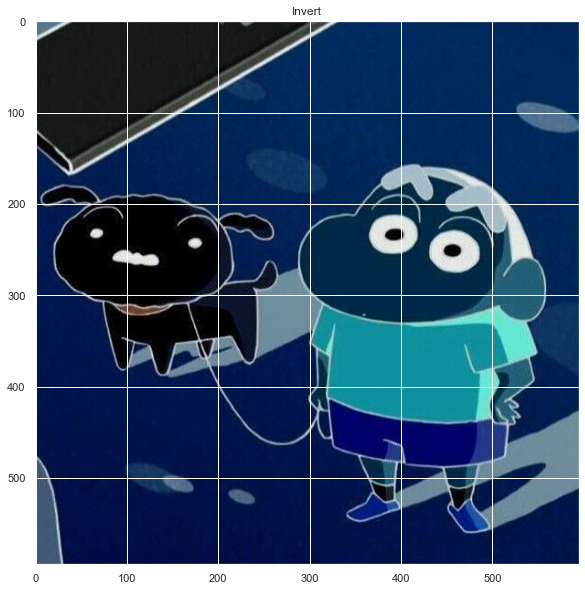

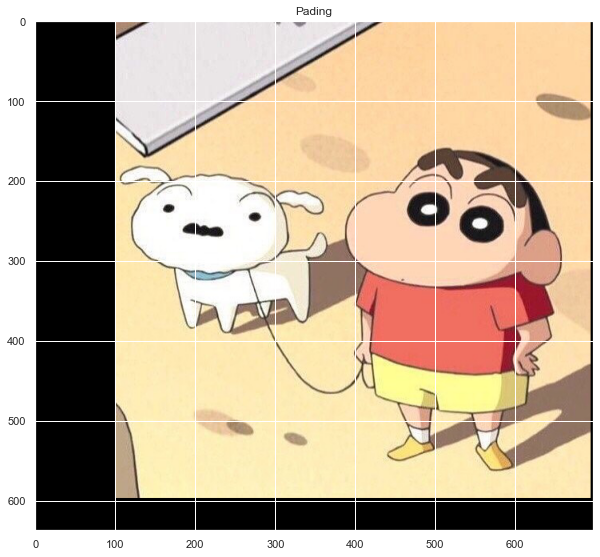

595
New Size torch.Size([3, 297, 297])


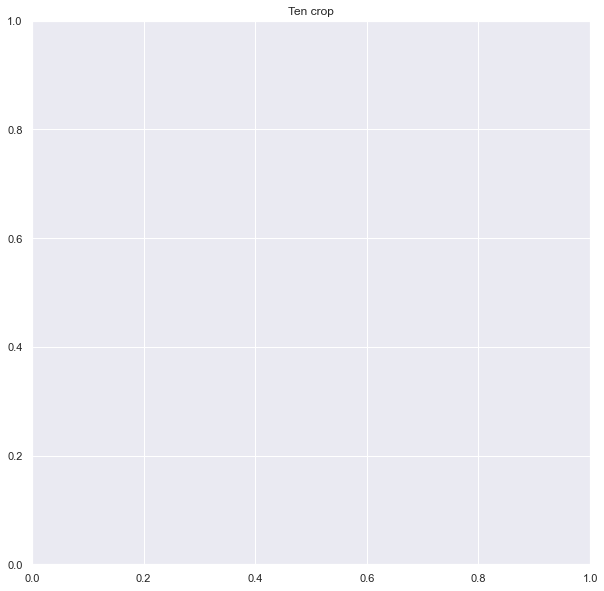

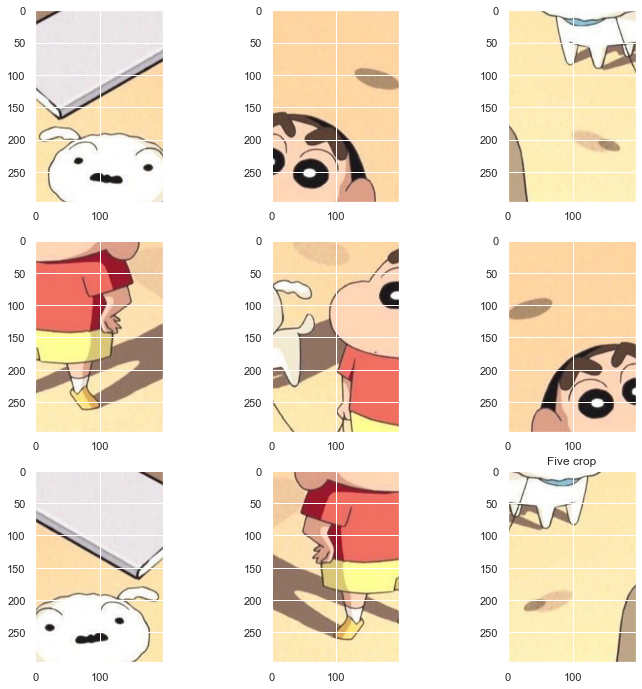

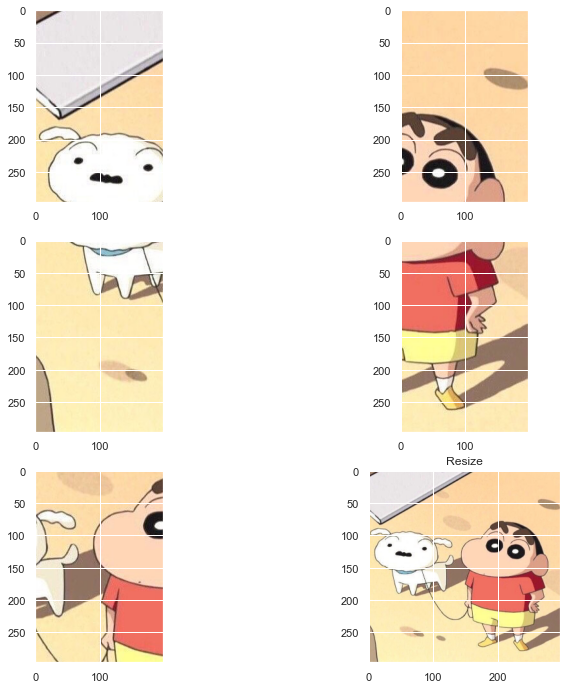

595


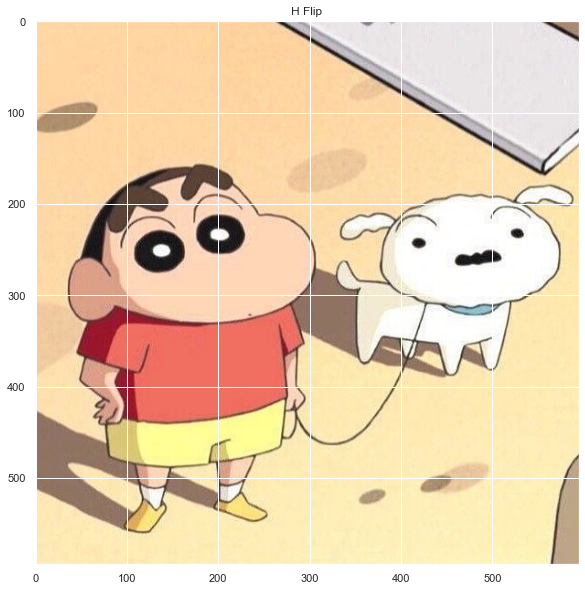

595


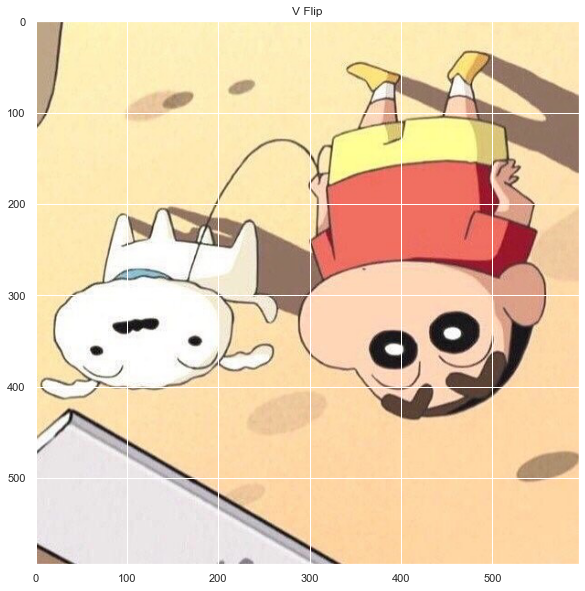

SyntaxError: keyword argument repeated: startpoints (1961035281.py, line 122)

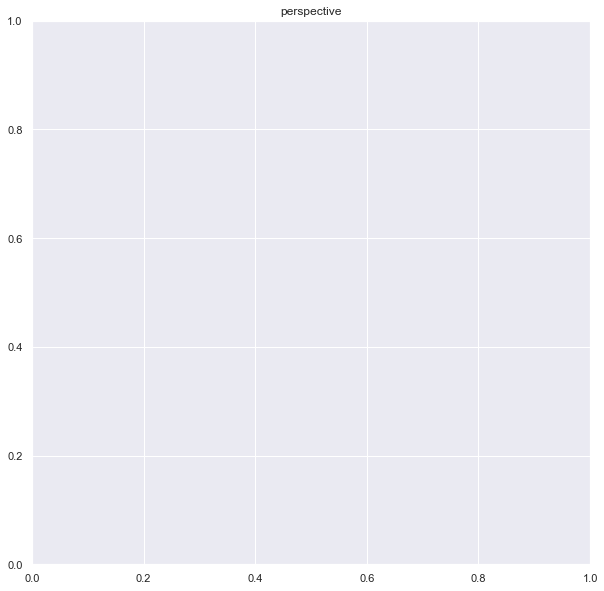

In [186]:
!pip3 install PIL
from PIL import Image
from torchvision.transforms import ToTensor, PILToTensor
# Pixel Movement
from torchvision.transforms.functional import (rotate,
                                               resize,
                                               pad,
                                               crop,
                                               center_crop,
                                               resized_crop,
                                               ten_crop,
                                               five_crop,
                                               hflip,
                                               vflip,
                                               invert,
                                               perspective)
from torchvision import datasets

import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))

import seaborn as sb
sb.set()


# Opening Image with PIL
img_name = "a1.jpeg"
pil_img = Image.open(img_name, mode='r')
display(pil_img)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_ = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()
        plt.figure(figsize=(10, 10))


def show_images(imgs, n_row=2, n_col=2):
    _, axs = plt.subplots(n_row, n_col, figsize=(12, 12))
    axs = axs.flatten()
    for img, ax in zip(imgs, axs):
        ax.imshow(img.permute(1, 2, 0))

    # plt.show()


# Rotate
plt.title("Rotate")
img = rotate(img=tensor_, angle=45, fill=False)
show_image(img)


# Resize
plt.title("Resize")
img = resize(img=tensor_, size=[500])
show_image(img)


# invert
plt.title("Invert")
img = invert(img=tensor_)
show_image(img)


# pad
plt.title("Pading")
img = pad(img=tensor_, padding=[100, 2, 3, 40])  # addming dark boder on the sides of the image
show_image(img)


# ten_crop
# Generate ten cropped images from the given image.
# Crop the given image into four corners and the central crop + horizontal flipping.
# if size is int than sqr matrix will gets created
plt.title("Ten crop")
imgs = ten_crop(tensor_,
              size=[tensor_.shape[1]//2, tensor_.shape[2]//3],
              vertical_flip=False)
show_images(imgs, n_row=3, n_col=3)


# five_crop
# if size is int than sqr matrix will gets created
plt.title("Five crop")
imgs = five_crop(img=tensor_,
                 size=[tensor_.shape[1]//2, tensor_.shape[2]//3])
show_images(imgs, n_row=3)



# Resize
plt.title("Resize")
print(tensor_.shape[1])
img = resize(img=tensor_,
            size=[tensor_.shape[1]//2, tensor_.shape[1]//2])  #  (h, w), height > width
print("New Size", img.shape)
show_image(img)



# H flip
plt.title("H Flip")
print(tensor_.shape[1])
img = hflip(img=tensor_)
show_image(img)


# V flip
plt.title("V Flip")
print(tensor_.shape[1])
img = vflip(img=tensor_)
show_image(img)


# perspective transform
plt.title("perspective")
img = perspective(img=tensor_,
                  startpoints=[1, 100, 120, 30],  # [top-left, top-right, bottom-right, bottom-left]
                  startpoints=[1, 100, 120, 30],
                  
                 )  #  (h, w), height > width
print("New Size", img.shape)
show_image(img)



transforms_perspective = Compose([
    RandomCrop(224),
    CenterCrop(size=[200,200]), 
    RandomPerspective(distortion_scale=1, p=1),
    ToTensor(),
    ])
print(transforms_perspective)



# def plotImages(images_arr):
#     fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))

#     if isinstance(axes, list):
#       axes = axes.flatten()
      
#       for img, ax in zip(images_arr, axes):
#         ax.imshow(img)
#     else:
#       axes.imshow(images_arr)
    
#     plt.tight_layout()
#     plt.show()

# plotImages(tensor_)



## Cropping

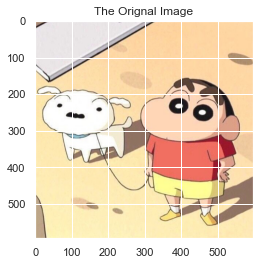

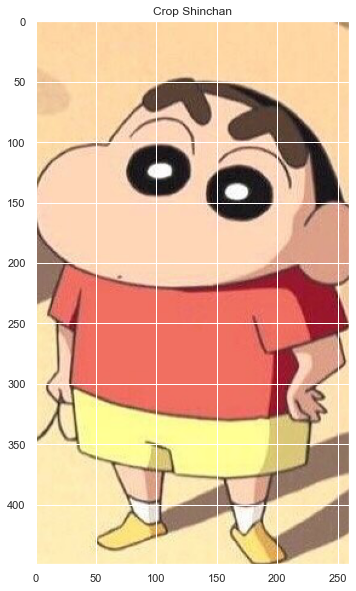

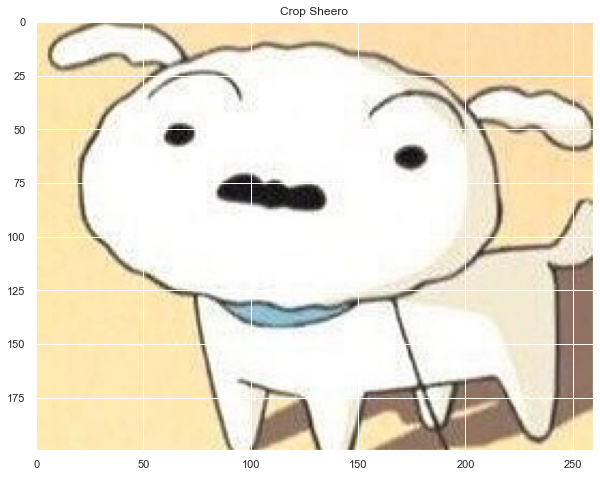


 center crop 



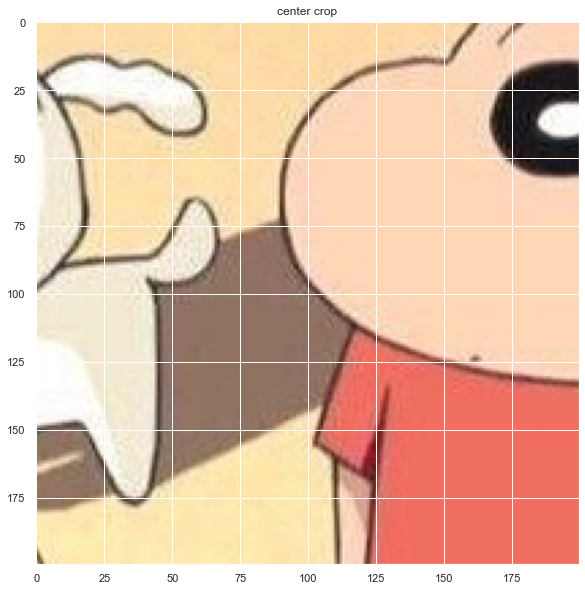

<Figure size 720x720 with 0 Axes>

In [185]:
plt.title("The Orignal Image")
show_image(tensor_)

plt.title("Crop Shinchan")
img = crop(img=tensor_,
           top=110,  # cropping along Y axis
           left=290,  # shifting along x-axis
           height=450,  # croping window height (based on object's size)
           width=260  # cropping along X axis
          )
show_image(img)


# Only Sheero crop
plt.title("Crop Sheero")
img = crop(img=tensor_,
           top=180,  # cropping along Y axis
           left=0,  # shifting along x-axis
           height=200,  # croping window height (based on object's size) 
           width=260  # cropping along X axis
          )
show_image(img)

print("\n center crop \n")
plt.title("center crop")
img = center_crop(tensor_, output_size=[200,200])
show_image(img)


## Random Transformation

'Original Image'

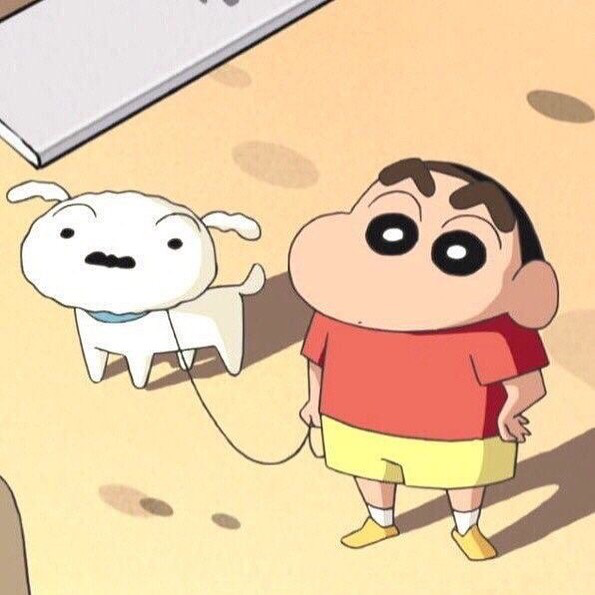

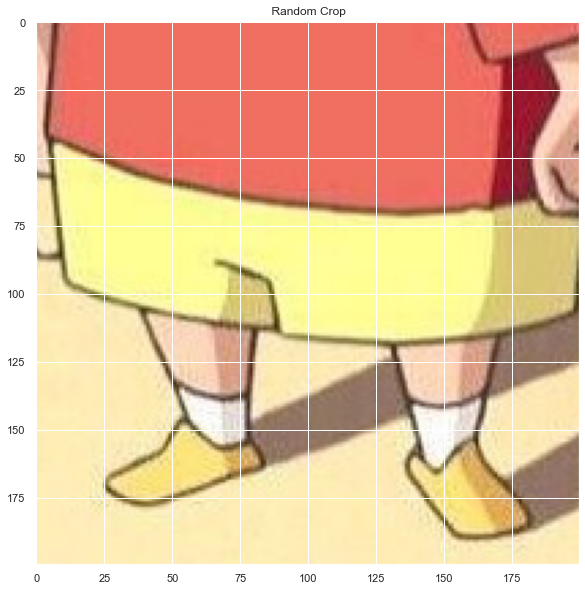

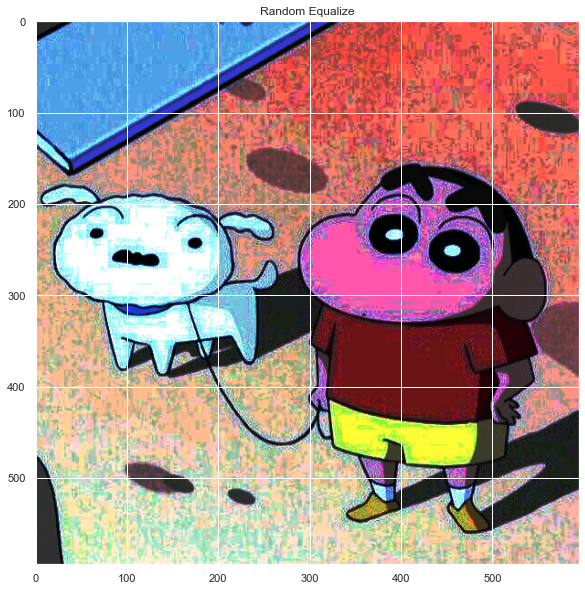

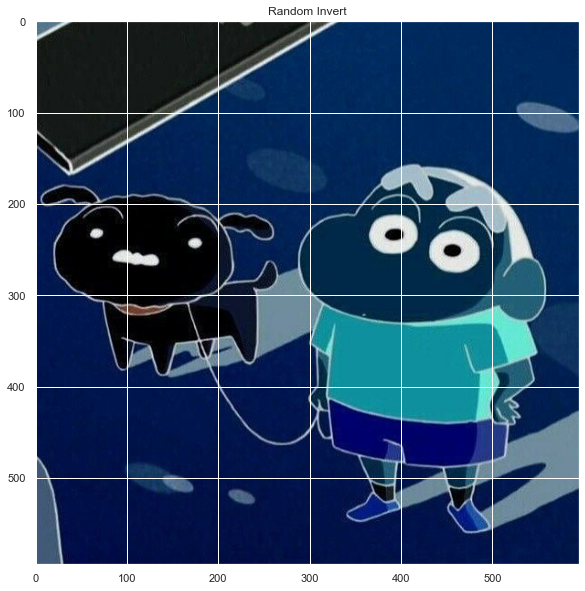

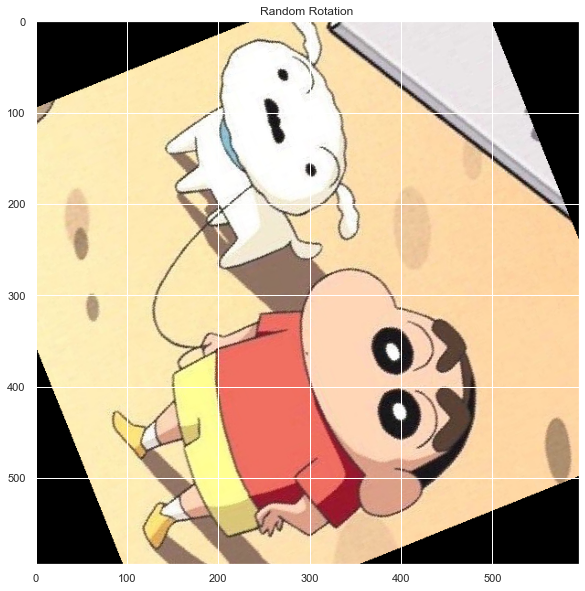

...

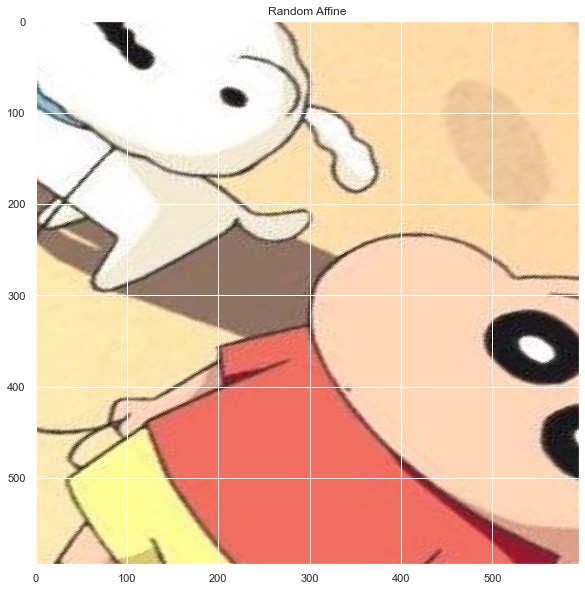

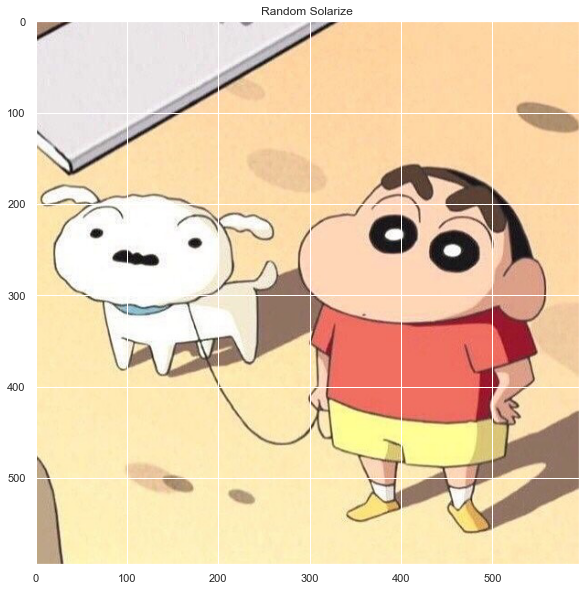

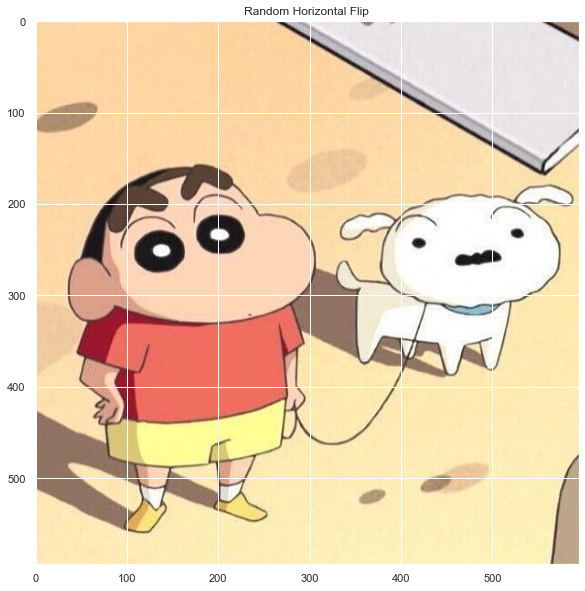

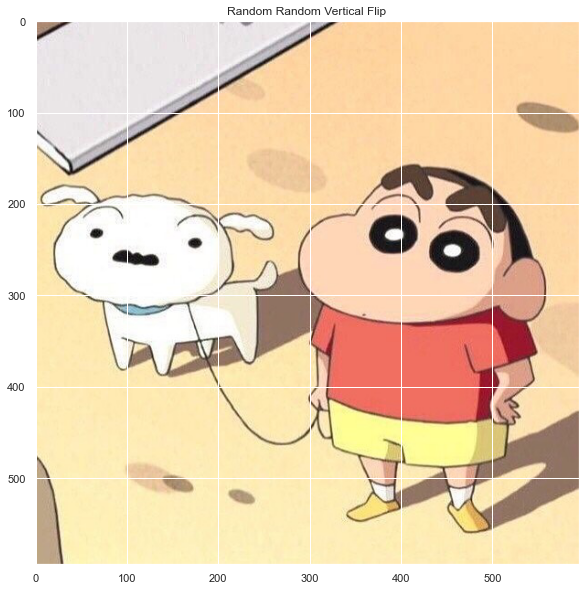

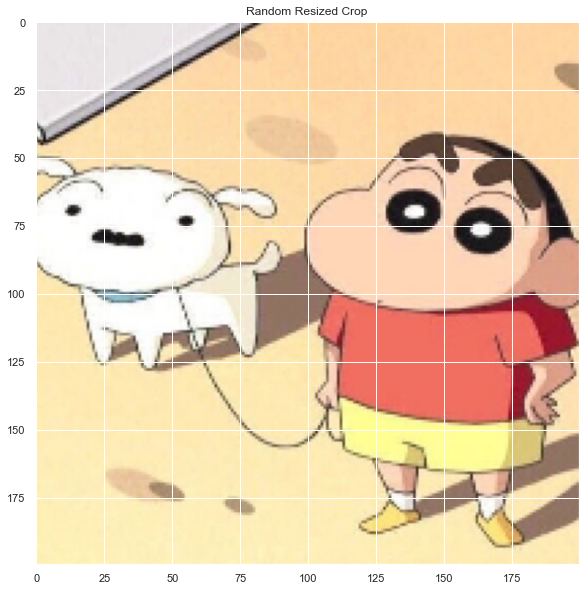

<Figure size 720x720 with 0 Axes>

In [244]:
plt.figure(figsize=(10, 10))


# Random Transformations
from torchvision.transforms import (RandomCrop,
                                    RandomEqualize,
                                    RandomInvert,
                                    RandomRotation,
                                    RandomAdjustSharpness,
                                    RandomGrayscale,
                                    RandomAffine,
                                    RandomSolarize,
                                    RandomHorizontalFlip,
                                    RandomVerticalFlip,
                                    RandomResizedCrop)

# Opening Image with PIL
img_name = "a1.jpeg"
pil_img = Image.open(img_name, mode='r')
display("Original Image", pil_img)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_img = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()
        plt.figure(figsize=(10, 10))


def show_images(imgs, n_row=2, n_col=2):
    _, axs = plt.subplots(n_row, n_col, figsize=(12, 12))
    axs = axs.flatten()
    for img, ax in zip(imgs, axs):
        ax.imshow(img.permute(1, 2, 0))


# Random Crop
plt.title(" Random Crop")
obj = RandomCrop(size=[200, 200])
show_image(obj(tensor_img))

# Random Equalize
plt.title("Random Equalize")
obj = RandomEqualize(p=0.6)
show_image(obj(tensor_img))


# Random Invert
plt.title("Random Invert")
obj = RandomInvert(p=0.6)
show_image(obj(tensor_img))


# Random Rotation
plt.title("Random Rotation")
obj = RandomRotation(degrees=90)
show_image(obj(tensor_img))

# Random Rotation with expand and fill
plt.title("Random Rotation with expand and fill")
obj = RandomRotation(degrees=90,
                    expand=True,
                    fill=77,  # filling the blank space with pixel 77
                    )
show_image(obj(tensor_img))


# RandomAdjustSharpness
plt.title("RandomAdjustSharpness")
obj = RandomAdjustSharpness(sharpness_factor=0,  # Can be -ve number. 0 --> blurred, 1 --> original, 2 --> sharpness by a factor of 2
                            p=0.6)
show_image(obj(tensor_img))


# RandomGrayscale ...............
plt.title("Random Grayscale")
obj = RandomGrayscale(p=0.8  # probability
                     )
show_image(obj(tensor_img))


# RandomAffine
plt.title("Random Affine")
obj = RandomAffine(degrees=90,
                   shear=90,  # 90 shear is best
                   scale=(1, 2),  # scale is ratio 1:2 is best, with scale adjust shear to 70
                  )
show_image(obj(tensor_img))


# RandomSolarize
plt.title("Random Solarize")
# i call it broken calculator
obj = RandomSolarize(threshold=254,  # Pixel Value
                     p=0.8)
show_image(obj(tensor_img))



# Random Horizontal Flip
plt.title("Random Horizontal Flip")
obj = RandomHorizontalFlip(p=0.8)
show_image(obj(tensor_img))


# RandomVerticalFlip
plt.title("Random Random Vertical Flip")
obj = RandomVerticalFlip(p=0.8)
show_image(obj(tensor_img))


# Random Resized Crop
plt.title("Random Resized Crop")
obj = RandomResizedCrop(size=[200, 200])
show_image(obj(tensor_img))


## Advanced Image Processing Functions

'Original Image'

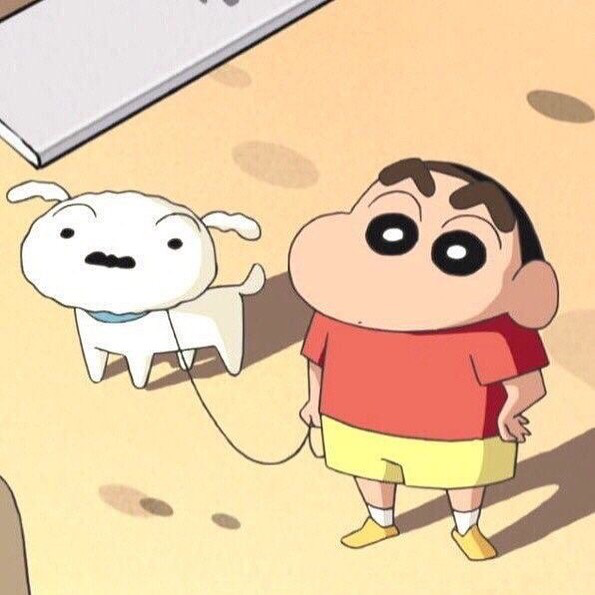

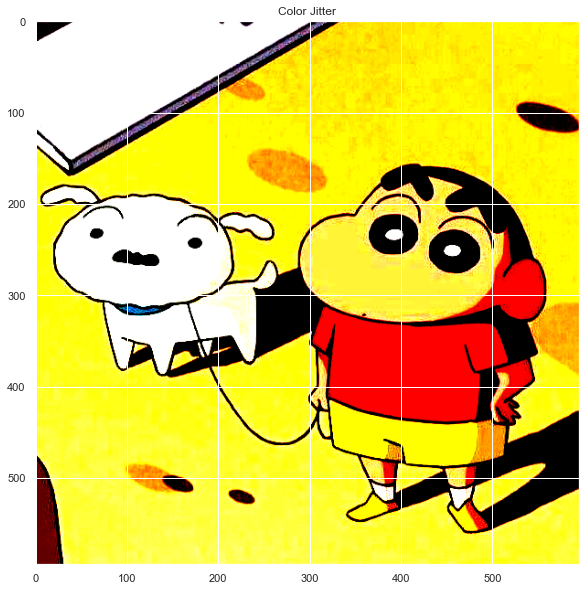

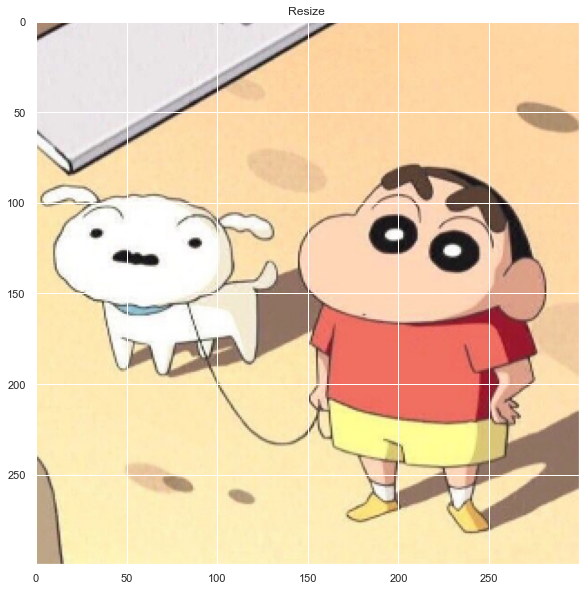

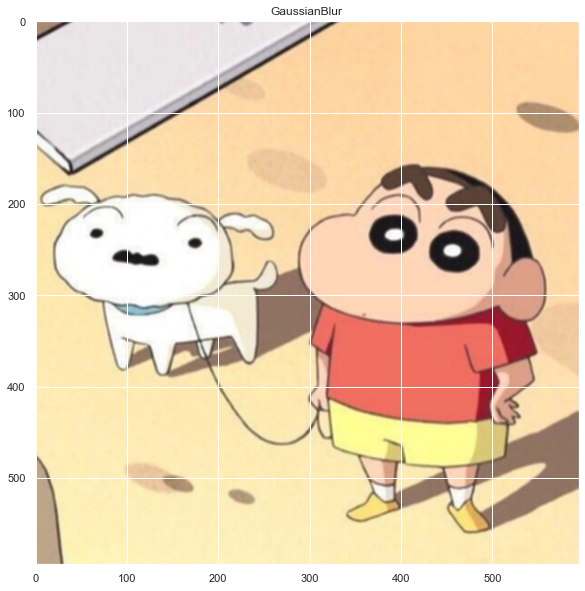

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


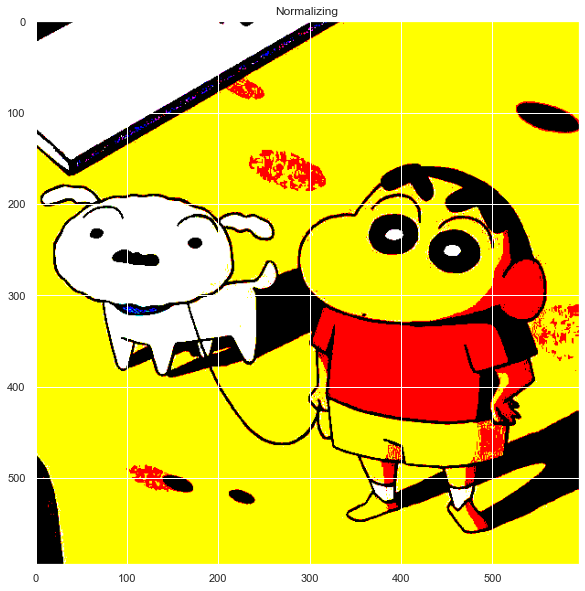

<Figure size 720x720 with 0 Axes>

In [381]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))


# Advanced Image Processing
from torchvision.transforms import (LinearTransformation,
                                    ColorJitter,
                                    GaussianBlur,
                                    Normalize,
                                    Lambda,  # 
                                    Resize,
                                    )

# Opening Image with PIL
img_name = "a1.jpeg"
pil_img = Image.open(img_name, mode='r')
display("Original Image", pil_img)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_img = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()
        plt.figure(figsize=(10, 10))


def show_images(imgs, n_row=2, n_col=2):
    _, axs = plt.subplots(n_row, n_col, figsize=(12, 12))
    axs = axs.flatten()
    for img, ax in zip(imgs, axs):
        ax.imshow(img.permute(1, 2, 0))


# Lambda,  # 
# Resize,


# LinearTransformation
# plt.title("Random Solarize")
# obj = LinearTransformation(transformation_matrix=torch.as_tensor(data=[[1,2,3], [3,22,32], [30, 31, 32]]),
#                            mean_vector=3)
# show_image(obj(tensor_img))


plt.title("Color Jitter")
obj = ColorJitter(brightness=0.1,  # must be +ve
                  contrast=5,  # 5 to 10 is good
                  # saturation=9,  # 1 to 9 is good saturation
                  hue=0,  #  0 <hue< 0.5, don't have to use in NN
                 )
show_image(obj(tensor_img))


# Resize
plt.title("Resize")
obj = Resize(size=[300, 300])
show_image(obj(tensor_img))



# GaussianBlur
plt.title("GaussianBlur")
obj = GaussianBlur(kernel_size=[3,3], sigma=(8, 9))
show_image(obj(tensor_img))


# Normalizing the image
plt.title("Normalizing")
obj = Normalize(mean=200,
               std=1,
               inplace=False)
show_image(obj(tensor_img.float()))

'Original Image'

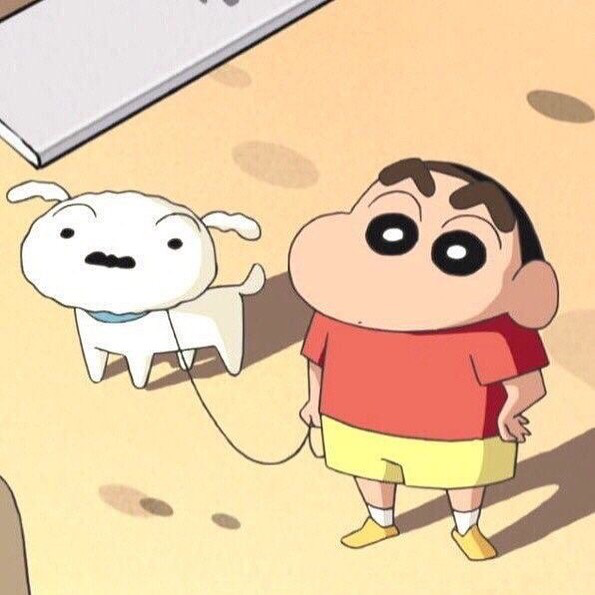

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


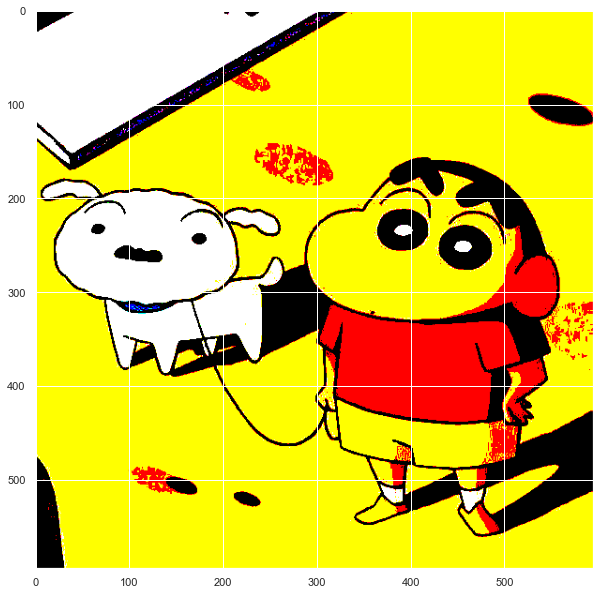

In [380]:
# Opening Image with PIL
plt.figure(figsize=(10, 13))

img_name = "a1.jpeg"
pil_img = Image.open(img_name, mode='r')
display("Original Image", pil_img)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_img = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()


obj = Normalize(mean=200,
               std=1,
               inplace=False)

show_image(obj(tensor_img.float()))


## Cuspon Pixel Manupulation

'Original Image'

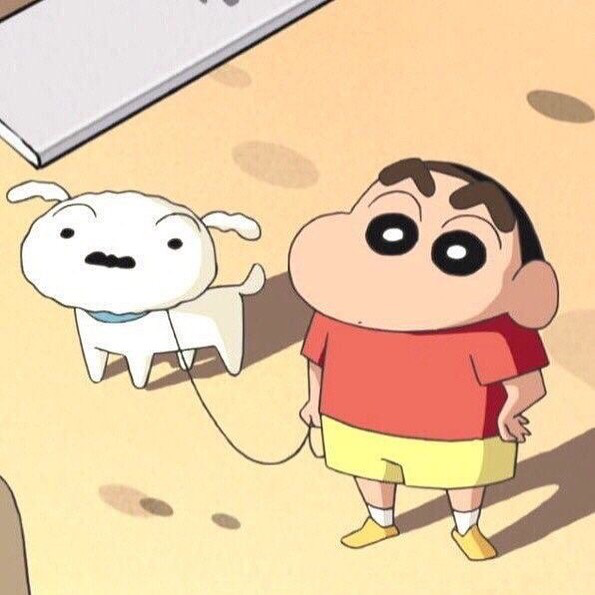

In [382]:
# Custom Pixel Manupulation
from torchvision.transforms.functional import (adjust_hue,
                                               adjust_brightness,
                                               adjust_gamma,
                                               adjust_saturation,
                                               adjust_sharpness,
                                               adjust_contrast,
                                               normalize,
                                               )

# Opening Image with PIL
img_name = "a1.jpeg"
pil_img = Image.open(img_name, mode='r')
display("Original Image", pil_img)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_img = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()
        plt.figure(figsize=(10, 10))


def show_images(imgs, n_row=2, n_col=2):
    _, axs = plt.subplots(n_row, n_col, figsize=(12, 12))
    axs = axs.flatten()
    for img, ax in zip(imgs, axs):
        ax.imshow(img.permute(1, 2, 0))
        

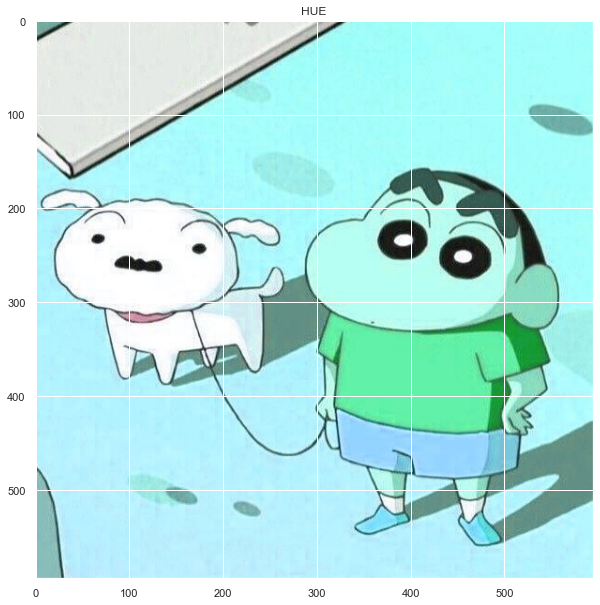

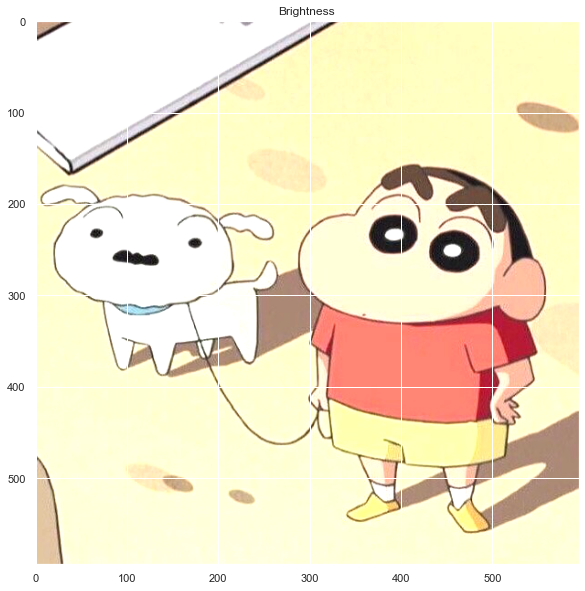

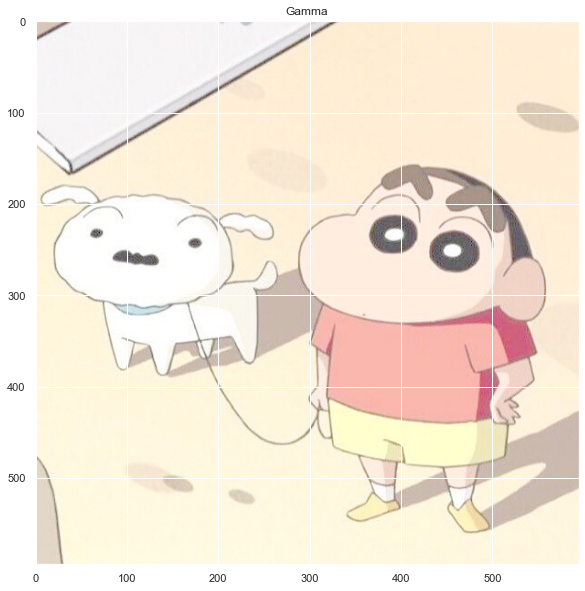

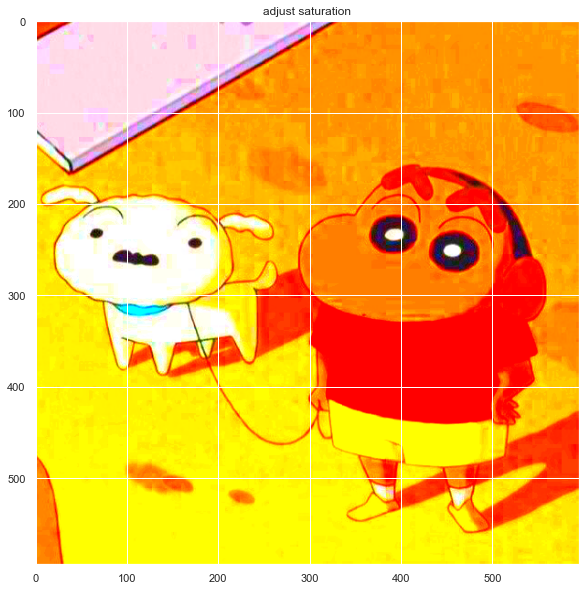

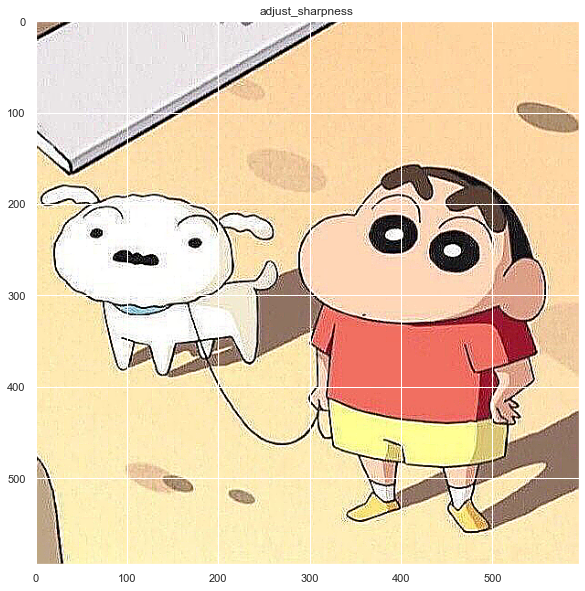

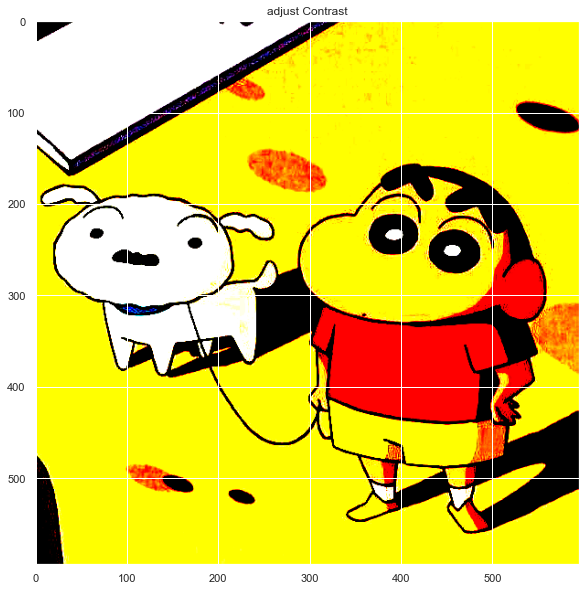

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


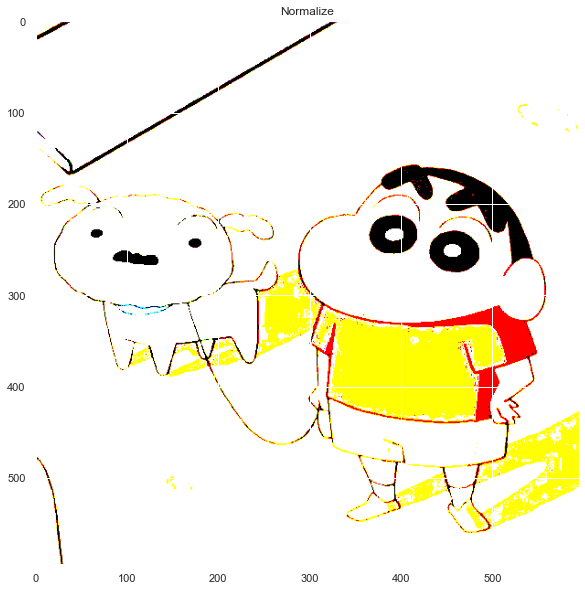

<Figure size 720x720 with 0 Axes>

In [406]:
# adjust_hue,
# adjust_brightness,
# adjust_gamma,
# adjust_saturation,
# adjust_sharpness,
# adjust_contrast,
# normalize
plt.figure(figsize=(10, 13))


# HUE
plt.title("HUE")
img = adjust_hue(img=tensor_img, hue_factor=0.4)
show_image(img)

# Brightness
plt.title("Brightness")
img = adjust_brightness(img=tensor_img, brightness_factor=1.2)
show_image(img)


# GAMMA
plt.title("Gamma")
img = adjust_gamma(img=tensor_img, gamma=0.4)
show_image(img)


# adjust_saturation
plt.title("adjust saturation")
img = adjust_saturation(img=tensor_img, saturation_factor=12)
show_image(img)


# adjust_sharpness
plt.title("adjust_sharpness")
img = adjust_sharpness(img=tensor_img, sharpness_factor=9)
show_image(img)


# adjust_contrast
plt.title("adjust Contrast")
img = adjust_contrast(img=tensor_img, contrast_factor=14)
show_image(img)


# normalize
# CAUTION the value of the pixels could be greater than 255 so we need to clip the value at 255 and 0 
plt.title("Normalize")
img = normalize(tensor=tensor_img.float(),
                mean=1,
                std=.2,
                inplace=False
               )
show_image(img-500)


## Chnage Pixel Properties


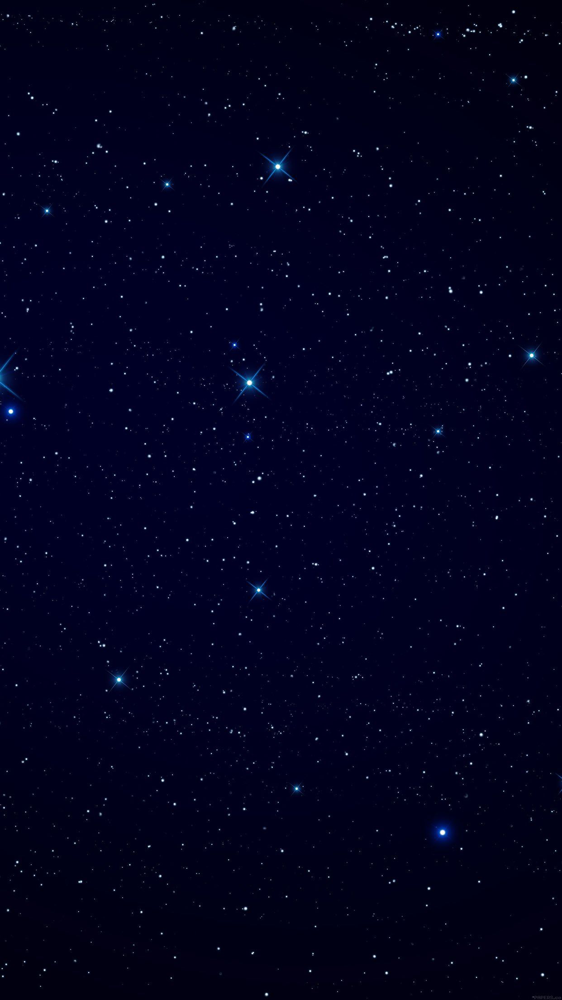


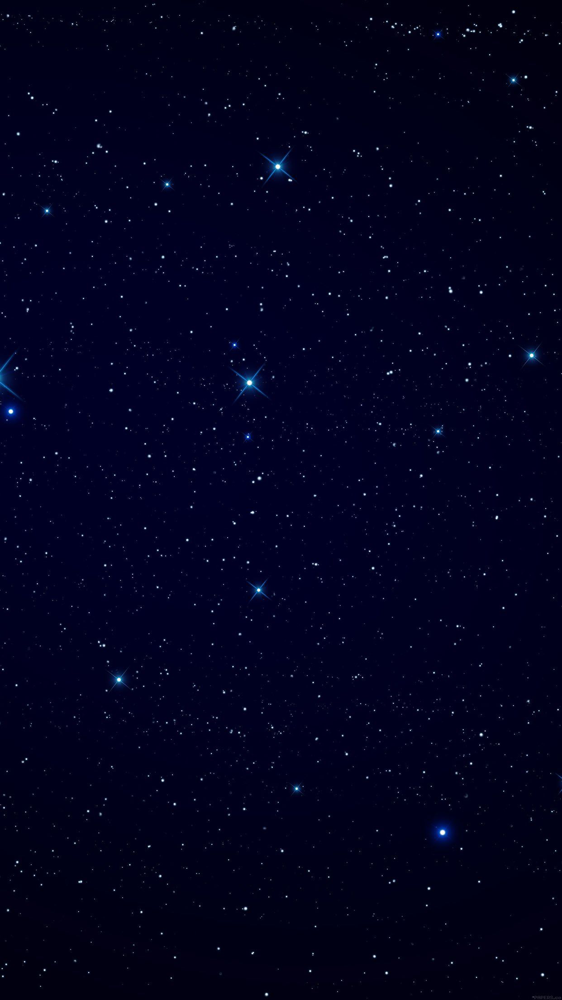

In [448]:
# !pip3 install ipyplot
from ipyplot import plot_images

# Change Pixel properties
from torchvision.transforms.functional import (affine,
                                               to_grayscale,
                                               rgb_to_grayscale,
                                               erase,
                                               solarize,
                                               posterize,
                                               autocontrast,
                                               equalize)

# Opening Image with PIL
img_name = "stars.jpeg"
pil_img = Image.open(img_name, mode='r')
# display("Original Image", pil_img)
    
plot_images(images=[pil_img],
                   img_width=300)


# Converting PIL to Tensor
PILToTensor_obj = PILToTensor()
tensor_img = PILToTensor_obj(pil_img)

def show_image(img, many=False):
    if many is False:
        plt.imshow(img.permute(1, 2, 0))
        plt.show()
        plt.figure(figsize=(10, 10))


def show_images(imgs, n_row=2, n_col=2):
    _, axs = plt.subplots(n_row, n_col, figsize=(12, 12))
    axs = axs.flatten()
    for img, ax in zip(imgs, axs):
        ax.imshow(img.permute(1, 2, 0))
 


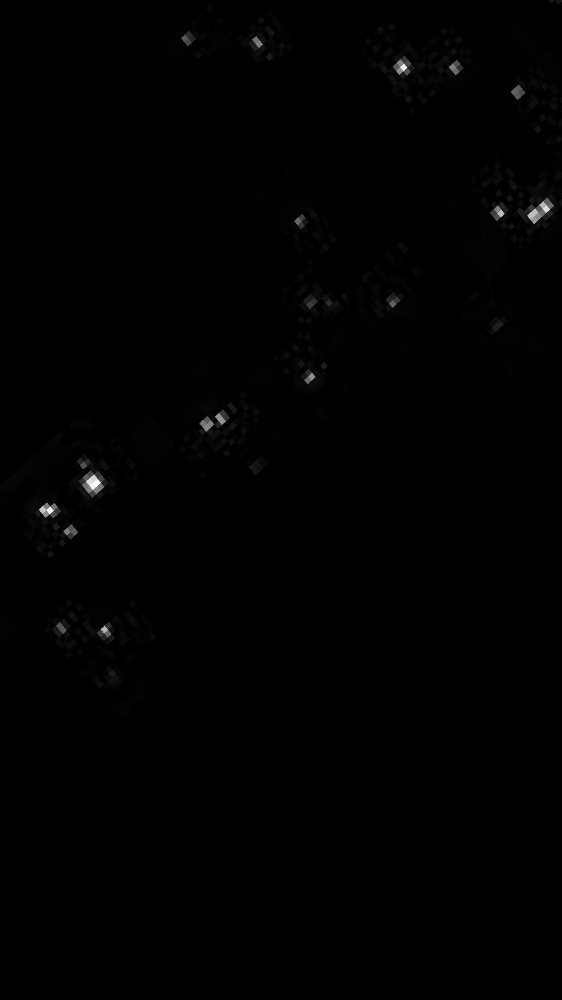
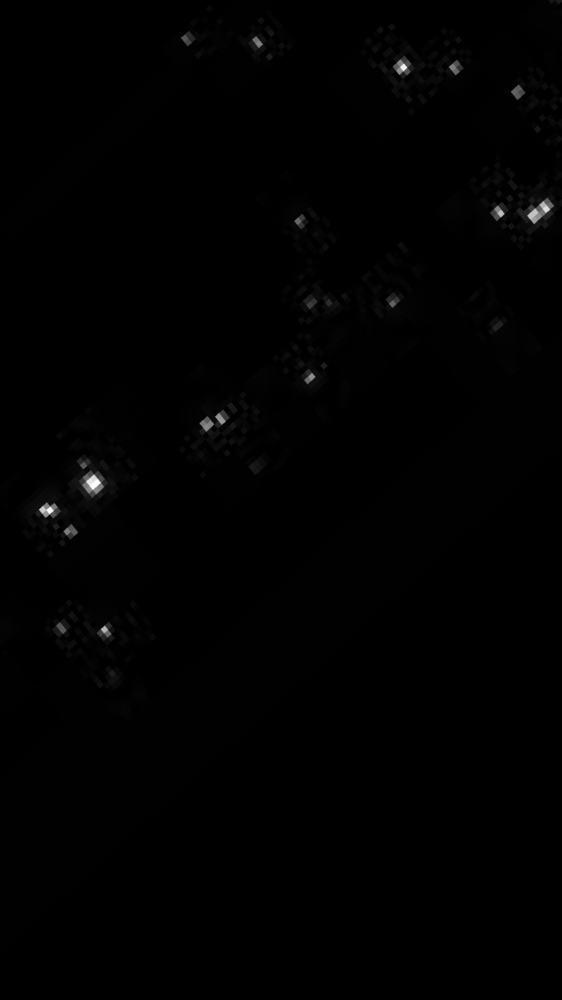
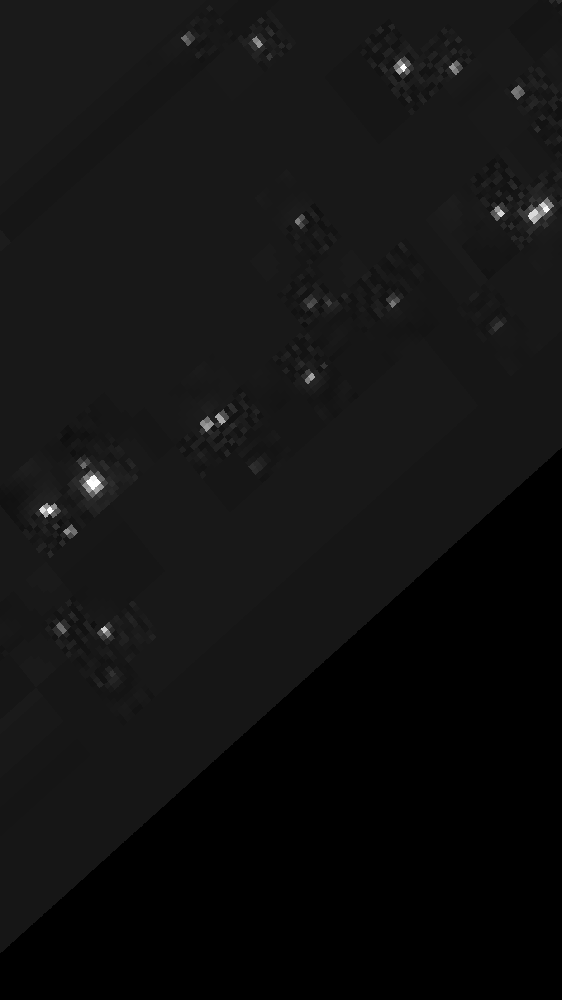


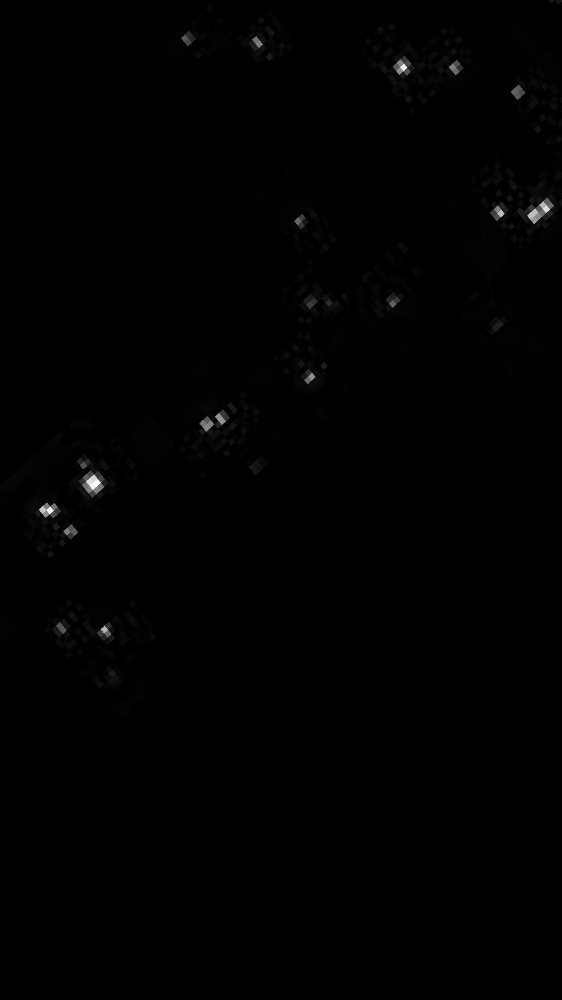
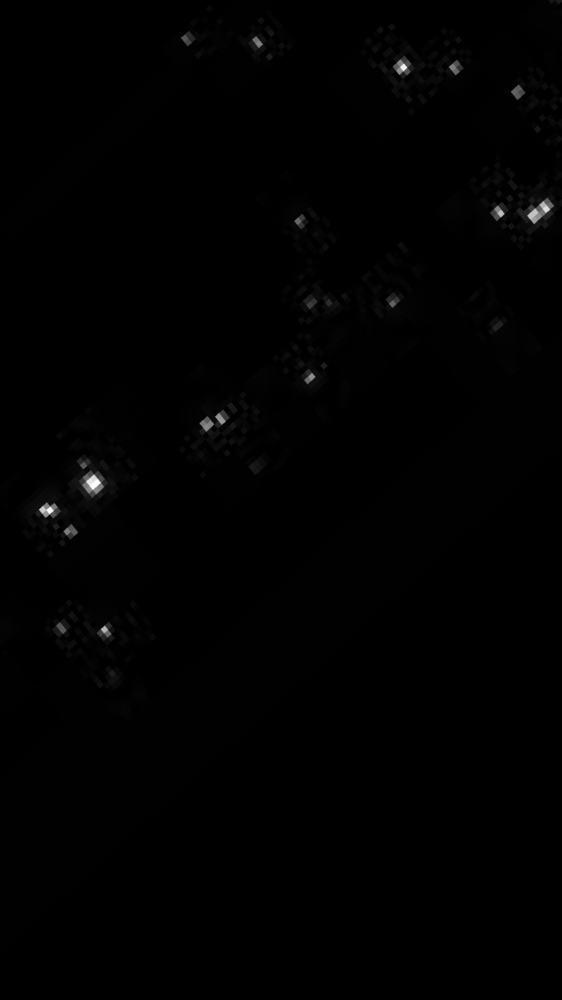
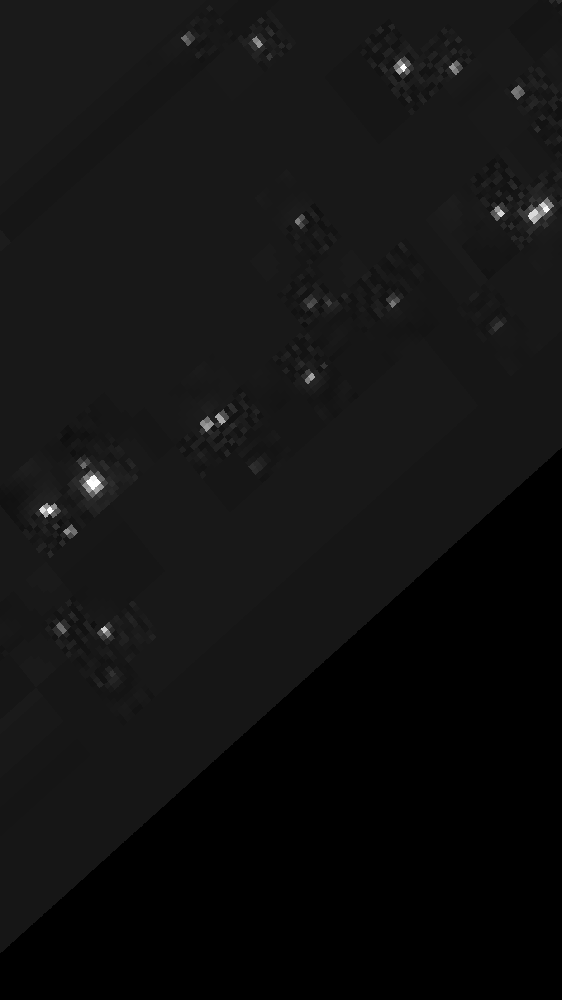

to grayscale channel 1 & 3



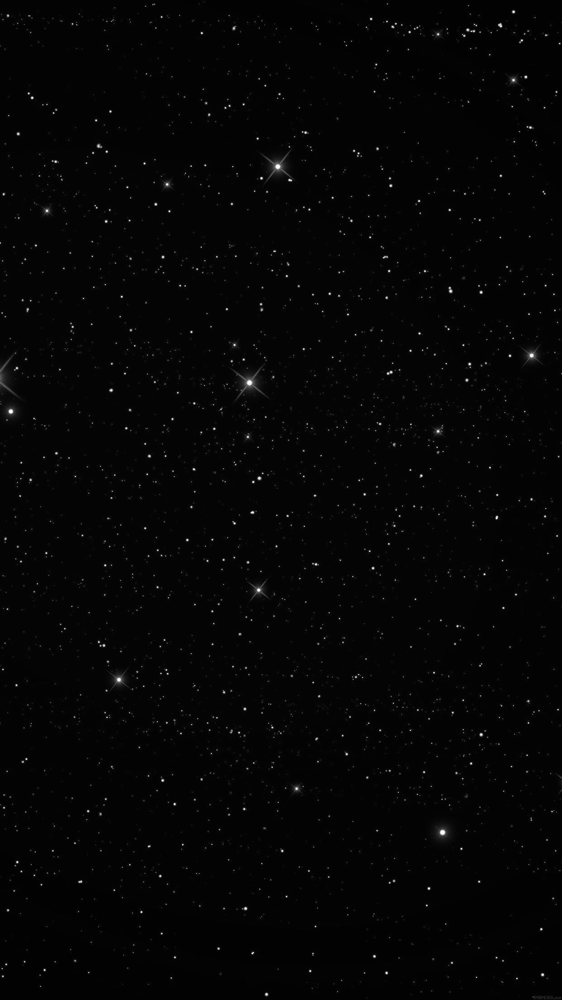
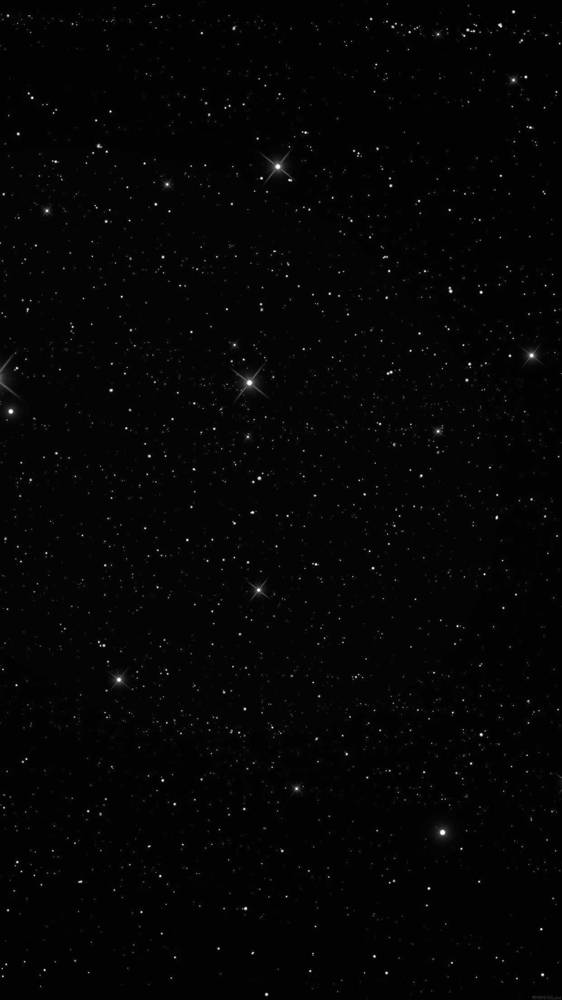


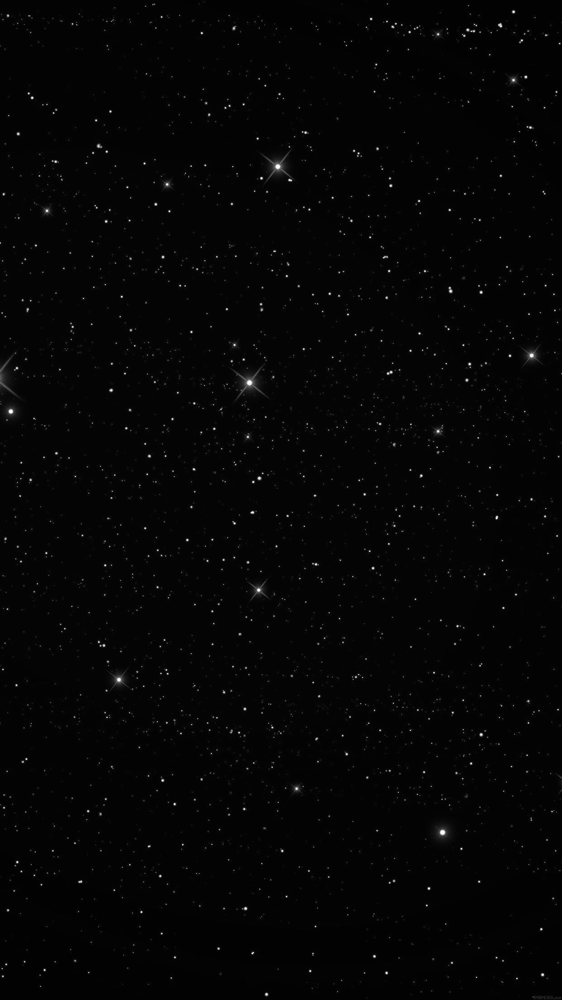
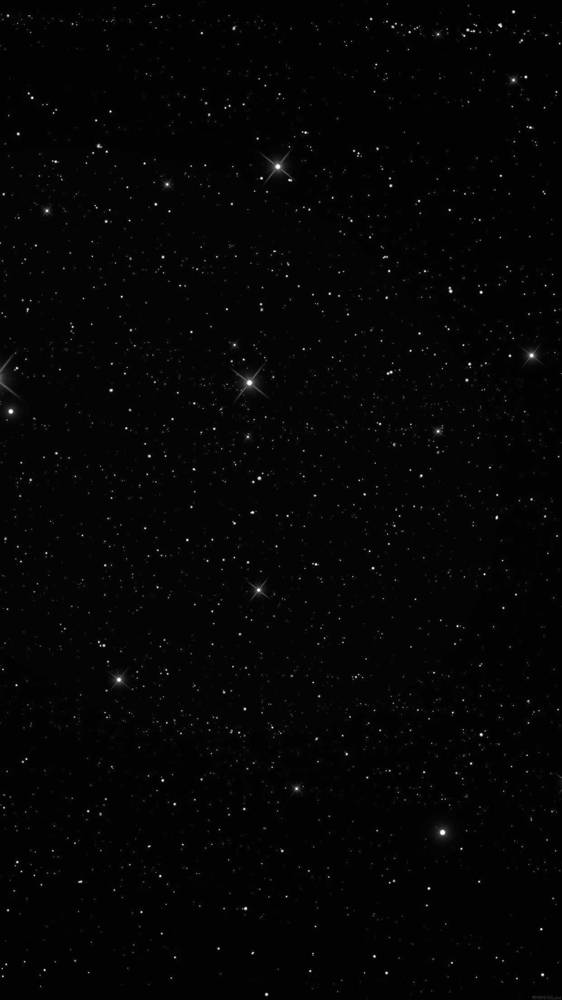

ValueError: num_output_channels should be either 1 or 3

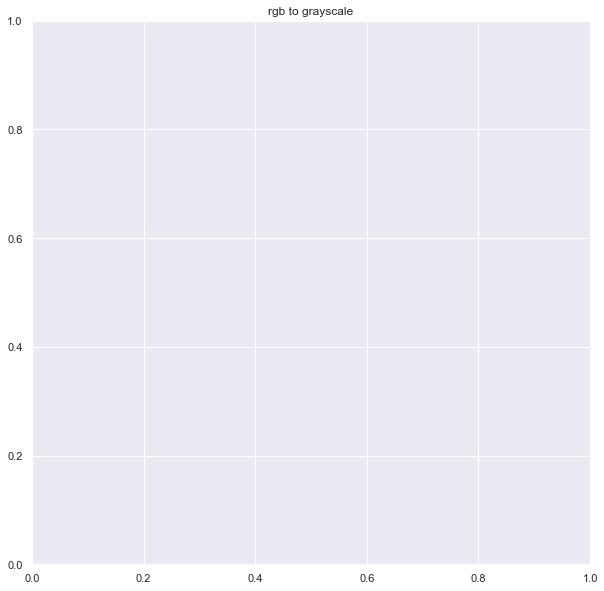

In [454]:
plt.figure(figsize=(10, 10))

# affine,
# to_grayscale,
# rgb_to_grayscale,
# erase,
# solarize,
# posterize,
# autocontrast,
# equalize


# affine
# TODO: Need to correct this
plt.title("affine Contrast")
img = affine(img=tensor_img,
             translate=(112,21),
             angle=140,
             scale=12,
             shear=[1,2],
             center=[110,110]
            )
plot_images(img)


# to_grayscale  [i/p and o/p is PIL]
print("to grayscale channel 1 & 3")
li = []
img1 = to_grayscale(img=pil_img, num_output_channels=1)
img3 = to_grayscale(img=pil_img, num_output_channels=3)  # num_output_channels 1 or 3
li.append(img1)
li.append(img3)

plot_images(images=li)


# rgb_to_grayscale
plt.title("rgb to grayscale")
img = rgb_to_grayscale(img=tensor_img, num_output_channels=2)
show_image(img, img_width=300)


# # erase
# plt.title("Erase")
# img = erase(img=tensor_img, contrast_factor=14)
# show_image(img)


# # solarize
# plt.title("solarize")
# img = solarize(img=tensor_img, contrast_factor=14)
# show_image(img)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


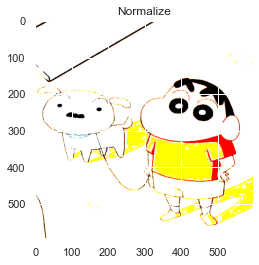

<Figure size 720x720 with 0 Axes>

# Pytorch Utilities

In [ ]:
#  utilities for vizualization in torchvision.utils
from torchvision.utils import  draw_bounding_boxes  # Draws bounding boxes on given image.
from torchvision.utils import  draw_segmentation_masks  # Draws segmentation masks on given RGB image.
from torchvision.utils import  make_grid  # Make a grid of images.
from torchvision.utils import  save_image  # Save a given Tensor into an image file


In [ ]:
# ref: https://github.com/jochemloedeman/CLIPHOI/blob/master/evaluators/clip_evaluator.py
# https://github.com/iamkanghyunchoi/qimera/blob/main/dataloader.py
# goo

# Fashion Dataset Training

In [ ]:
from torchvision.datasets import FashionMNIST
from torchvision.transforms import ToTensor

training_data = FashionMNIST(
    root="data",
    train=True,
    download=True,
    transform=ToTensor()
)


test_data = FashionMNIST(
    root="data",
    train=False,
    download=True,
    transform=ToTensor()
)

print("FashionMNIST", FashionMNIST.classes)

# mapping the codes with the class_label
labels_map = {i: FashionMNIST.classes[i] for i in range(len(FashionMNIST.classes)) }
# the other way: dict( zip(list1, list2) )
print(labels_map)

FashionMNIST ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
{0: 'T-shirt/top', 1: 'Trouser', 2: 'Pullover', 3: 'Dress', 4: 'Coat', 5: 'Sandal', 6: 'Shirt', 7: 'Sneaker', 8: 'Bag', 9: 'Ankle boot'}


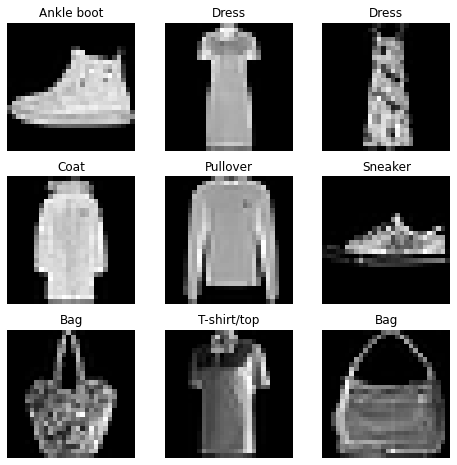

In [ ]:
"""
Plotting Data


# creates list_of_tensor of len 2, of values 0<= x <100 
torch.randint(high=100, size=(2,))

the .item convert the list_of_tensor into number only if list_of_tensor has 1 element

"""

figure = plt.figure(figsize=(8, 8))

no_of_training_points = len(training_data)
cols, rows = 3, 3
for i in range(1, cols * rows + 1):
    sample_idx = torch.randint(high=no_of_training_points,
                               size=(1,)).item()
    
    # img is of nested Tensor and label is int for that class
    img, label = training_data[sample_idx]
    
    figure.add_subplot(rows, cols, i)
    plt.title(labels_map[label])
    plt.axis("off")
    plt.imshow(img.squeeze(), cmap="gray")

plt.show()

# you can see that
# training_data[100]

# City scapes Data

In [ ]:
# type: ignore[override]
from typing import Any, Callable

from pytorch_lightning import LightningDataModule
from torch.utils.data import DataLoader

from ConSSL.utils import _TORCHVISION_AVAILABLE
from ConSSL.utils.warnings import warn_missing_pkg

if _TORCHVISION_AVAILABLE:
    from torchvision import transforms as transform_lib
    from torchvision.datasets import Cityscapes
else:  # pragma: no cover
    warn_missing_pkg('torchvision')


class CityscapesDataModule(LightningDataModule):
    """
    .. figure:: https://www.cityscapes-dataset.com/wordpress/wp-content/uploads/2015/07/muenster00-1024x510.png
        :width: 400
        :alt: Cityscape

    Standard Cityscapes, train, val, test splits and transforms

    Note: You need to have downloaded the Cityscapes dataset first and provide the path to where it is saved.
        You can download the dataset here: https://www.cityscapes-dataset.com/

    Specs:
        - 30 classes (road, person, sidewalk, etc...)
        - (image, target) - image dims: (3 x 1024 x 2048), target dims: (1024 x 2048)

    Transforms::

        transforms = transform_lib.Compose([
            transform_lib.ToTensor(),
            transform_lib.Normalize(
                mean=[0.28689554, 0.32513303, 0.28389177],
                std=[0.18696375, 0.19017339, 0.18720214]
            )
        ])

    Example::

        from ConSSL.datamodules import CityscapesDataModule

        dm = CityscapesDataModule(PATH)
        model = LitModel()

        Trainer().fit(model, datamodule=dm)

    Or you can set your own transforms

    Example::

        dm.train_transforms = ...
        dm.test_transforms = ...
        dm.val_transforms  = ...
        dm.target_transforms = ...
    """

    name = 'Cityscapes'
    extra_args: dict = {}

    def __init__(
        self,
        data_dir: str,
        quality_mode: str = 'fine',
        target_type: str = 'instance',
        num_workers: int = 16,
        batch_size: int = 32,
        seed: int = 42,
        shuffle: bool = False,
        pin_memory: bool = False,
        drop_last: bool = False,
        *args: Any,
        **kwargs: Any,
    ) -> None:
        """
        Args:
            data_dir: where to load the data from path, i.e. where directory leftImg8bit and gtFine or gtCoarse
                are located
            quality_mode: the quality mode to use, either 'fine' or 'coarse'
            target_type: targets to use, either 'instance' or 'semantic'
            num_workers: how many workers to use for loading data
            batch_size: number of examples per training/eval step
            seed: random seed to be used for train/val/test splits
            shuffle: If true shuffles the data every epoch
            pin_memory: If true, the data loader will copy Tensors into CUDA pinned memory before
                        returning them
            drop_last: If true drops the last incomplete batch
        """
        super().__init__(*args, **kwargs)

        if not _TORCHVISION_AVAILABLE:  # pragma: no cover
            raise ModuleNotFoundError(
                'You want to use CityScapes dataset loaded from `torchvision` which is not installed yet.'
            )

        if target_type not in ['instance', 'semantic']:
            raise ValueError(f'Only "semantic" and "instance" target types are supported. Got {target_type}.')

        self.dims = (3, 1024, 2048)
        self.data_dir = data_dir
        self.quality_mode = quality_mode
        self.target_type = target_type
        self.num_workers = num_workers
        self.batch_size = batch_size
        self.seed = seed
        self.shuffle = shuffle
        self.pin_memory = pin_memory
        self.drop_last = drop_last
        self.target_transforms = None

    @property
    def num_classes(self) -> int:
        """
        Return:
            30
        """
        return 30

    def train_dataloader(self) -> DataLoader:
        """
        Cityscapes train set
        """
        transforms = self.train_transforms or self._default_transforms()
        target_transforms = self.target_transforms or self._default_target_transforms()

        dataset = Cityscapes(
            self.data_dir,
            split='train',
            target_type=self.target_type,
            mode=self.quality_mode,
            transform=transforms,
            target_transform=target_transforms,
            **self.extra_args
        )

        loader = DataLoader(
            dataset,
            batch_size=self.batch_size,
            shuffle=self.shuffle,
            num_workers=self.num_workers,
            drop_last=self.drop_last,
            pin_memory=self.pin_memory
        )
        return loader

    def val_dataloader(self) -> DataLoader:
        """
        Cityscapes val set
        """
        transforms = self.val_transforms or self._default_transforms()
        target_transforms = self.target_transforms or self._default_target_transforms()

        dataset = Cityscapes(
            self.data_dir,
            split='val',
            target_type=self.target_type,
            mode=self.quality_mode,
            transform=transforms,
            target_transform=target_transforms,
            **self.extra_args
        )

        loader = DataLoader(
            dataset,
            batch_size=self.batch_size,
            shuffle=False,
            num_workers=self.num_workers,
            pin_memory=self.pin_memory,
            drop_last=self.drop_last
        )
        return loader

    def test_dataloader(self) -> DataLoader:
        """
        Cityscapes test set
        """
        transforms = self.test_transforms or self._default_transforms()
        target_transforms = self.target_transforms or self._default_target_transforms()

        dataset = Cityscapes(
            self.data_dir,
            split='test',
            target_type=self.target_type,
            mode=self.quality_mode,
            transform=transforms,
            target_transform=target_transforms,
            **self.extra_args
        )
        loader = DataLoader(
            dataset,
            batch_size=self.batch_size,
            shuffle=False,
            num_workers=self.num_workers,
            drop_last=self.drop_last,
            pin_memory=self.pin_memory
        )
        return loader

    def _default_transforms(self) -> Callable:
        cityscapes_transforms = transform_lib.Compose([
            transform_lib.ToTensor(),
            transform_lib.Normalize(
                mean=[0.28689554, 0.32513303, 0.28389177], std=[0.18696375, 0.19017339, 0.18720214]
            )
        ])
        return cityscapes_transforms

    def _default_target_transforms(self) -> Callable:
        cityscapes_target_trasnforms = transform_lib.Compose([
            transform_lib.ToTensor(), transform_lib.Lambda(lambda t: t.squeeze())
        ])
        return cityscapes_target_trasnforms